# Create pendelum data, (time, theta1, theta2)

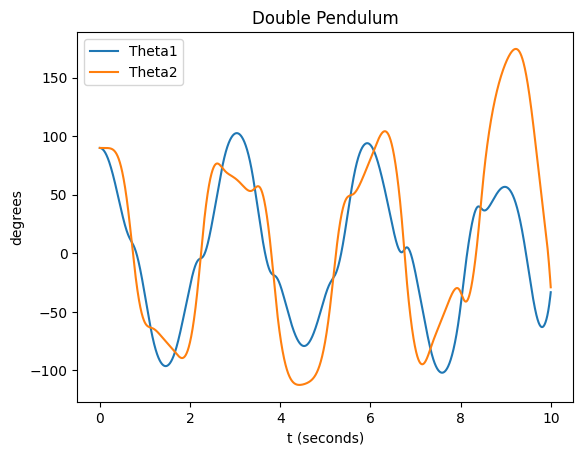

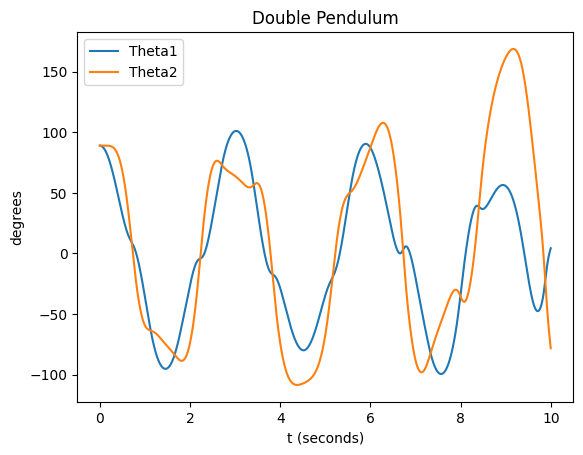

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from math import sin, cos, pi
from numpy import array, arange, zeros_like
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import mean_squared_error, r2_score

g = 9.81
L1 = 1
L2 = 1
m1 = 1.0
m2 = 1.0

def f(r, t, L1, L2):
    theta1 = r[0]
    omega1 = r[1]
    theta2 = r[2]
    omega2 = r[3]

    ftheta1 = omega1
    fomega1 = (-g * (2 * m1 + m2) * sin(theta1) - m2 * g * sin(theta1 - 2 * theta2) - 2 * sin(theta1 - theta2) * m2 *
               (omega2**2 * L2 + omega1**2 * L1 * cos(theta1 - theta2))) / (L1 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    ftheta2 = omega2
    fomega2 = (2 * sin(theta1 - theta2) * (omega1**2 * L1 * (m1 + m2) + g * (m1 + m2) * cos(theta1) + omega2**2 * L2 * m2 *
                                           cos(theta1 - theta2))) / (L2 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    return array([ftheta1, fomega1, ftheta2, fomega2], float)

a = 0.0
b = 10
N = 5000
h = (b - a) / N

angles = [[90, 90],[89, 89]]

for x in angles:
  tpoints = np.arange(a, b, h) # seconds, split into intervals of 100
  theta1_points = np.zeros_like(tpoints) # what the first pendulm angle should be (empty)
  theta2_points = np.zeros_like(tpoints) # what the second pendulm angle should be (empty)

  q = np.array([x[0]*pi/180, 0, x[1]*pi/180, 0], float)

  for i, t in enumerate(tpoints):
      theta1_points[i] = q[0] * 180 / pi # converted from theta (θ) to degrees (°)
      theta2_points[i] = q[2] * 180 / pi

      k1 = h * f(q, t, L1, L2)
      k2 = h * f(q + 0.5 * k1, t + 0.5 * h, L1, L2)
      k3 = h * f(q + 0.5 * k2, t + 0.5 * h, L1, L2)
      k4 = h * f(q + k3, t + h, L1, L2)
      q += (k1 + 2 * k2 + 2 * k3 + k4) / 6

  plt.plot(tpoints, theta1_points, label='Theta1') # what the first pendulm is (populated)
  plt.plot(tpoints, theta2_points, label='Theta2') # what the second pendulm is (populated)
  plt.title("Double Pendulum")
  plt.xlabel("t (seconds)")
  plt.ylabel("degrees")
  plt.legend()
  plt.show()

  data = np.stack((theta1_points, theta2_points), axis=1)
  np.save(f'pendulum_data_{str(x[0])}_{str(x[1])}.npy', data)

# Turn data into inputs and outputs and setup model

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader

# Define the dataset class
class QuadraticDataset(Dataset):
    def __init__(self, x, y):
        self.x = torch.tensor(x, dtype=torch.float32)  # Shape (N, 2)
        self.y = torch.tensor(y, dtype=torch.float32)  # Shape (N, 2)

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return self.x[idx], self.y[idx]

data = {}

for i in angles:
  loaded_data = np.load(f'pendulum_data_{str(i[0])}_{str(i[1])}.npy')
  scaler = MinMaxScaler()
  data_ = scaler.fit_transform(loaded_data)
  data[f'{str(i[0])}_{str(i[1])}'] = data_

print(data)


def create_io(data):
    x, x_1, x_2, y_1, y_2 = [], [], [], [], []
    # for i in angles
    for starting in data:
      starting_theta_1_degrees = int(starting.split("_")[0])
      starting_theta_2_degrees = int(starting.split("_")[1])

      starting_theta_1 = starting_theta_1_degrees * pi /180
      starting_theta_2 = starting_theta_2_degrees * pi /180

      angle_data = data[starting]
      for i in range(len(angle_data)):
          x.append(tpoints[i])
          x_1.append(starting_theta_1)
          x_2.append(starting_theta_2)
          y_1.append(angle_data[i][0])
          y_2.append(angle_data[i][1])
    return x, x_1, x_2, y_1, y_2

x, x_1, x_2, y_1, y_2 = create_io(data)

# Normalize data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

# Combine x_1 and x_2 into one feature matrix
x_combined = np.vstack([x_1, x_2, x]).T
x_scaled = scaler_x.fit_transform(x_combined)

# Combine y_1 and y_2 into one target matrix
y_combined = np.vstack([y_1, y_2]).T
y_scaled = scaler_y.fit_transform(y_combined)

# Create dataset and dataloaders
dataset = QuadraticDataset(x_scaled, y_scaled)
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=10, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=10, shuffle=False)

# Define the model class
class ImprovedStackedRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers):
        super(ImprovedStackedRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True, nonlinearity='relu')
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # x should be (batch_size, sequence_length, input_size)
        out, _ = self.rnn(x)
        # out should be (batch_size, sequence_length, hidden_size)
        out = self.fc(out[:, -1, :])  # Output from the final time step
        return out

{'90_90': array([[0.93814809, 0.7052745 ],
       [0.9381426 , 0.7052745 ],
       [0.93812613, 0.7052745 ],
       ...,
       [0.32926491, 0.29826612],
       [0.3326211 , 0.29443116],
       [0.33599928, 0.29058126]]), '89_89': array([[0.93973594, 0.71236406],
       [0.93973034, 0.71236406],
       [0.93971352, 0.71236406],
       ...,
       [0.514824  , 0.11428143],
       [0.51603593, 0.11174853],
       [0.51722454, 0.10922964]])}


# Train le data

In [4]:
# Create a new model instance
input_size = 3  # Two input features
hidden_size = 100
output_size = 2  # Two output values
num_layers = 5
srnn = ImprovedStackedRNN(input_size, hidden_size, output_size, num_layers)

# Define loss function and optimizer
loss_function = nn.MSELoss()
optimizer = optim.Adam(srnn.parameters(), lr=0.001)

early_stopping_patience = 10
best_loss = float('inf')
patience_counter = 0

# Training function with early stopping
def train_model(model, train_loader, test_loader, num_epochs):
    best_loss = float('inf')
    patience_counter = 0
    best_model = None

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for sequences, targets in train_loader:
            sequences = sequences.unsqueeze(1)  # Add sequence dimension
            targets = targets  # Target should be (batch_size, output_size)
            optimizer.zero_grad()
            y_pred = model(sequences)
            loss = loss_function(y_pred, targets)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        train_loss /= len(train_loader)

        model.eval()
        test_loss = 0
        all_preds = []
        all_targets = []
        with torch.no_grad():
            for sequences, targets in test_loader:
                sequences = sequences.unsqueeze(1)  # Add sequence dimension
                targets = targets
                y_pred = model(sequences)
                loss = loss_function(y_pred, targets)
                test_loss += loss.item()
                all_preds.append(y_pred)
                all_targets.append(targets)

        test_loss /= len(test_loader)

        # Flatten the lists and convert to numpy arrays
        all_preds = torch.cat(all_preds).numpy()
        all_targets = torch.cat(all_targets).numpy()

        r2 = r2_score(all_targets, all_preds, multioutput='uniform_average')
        print(f'Epoch {epoch+1}, Train Loss: {train_loss}, Test Loss: {test_loss}, R^2 Score: {r2}')

        if test_loss < best_loss:
            best_loss = test_loss
            best_model = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= early_stopping_patience:
            print("Early stopping")
            break

    if best_model:
        model.load_state_dict(best_model)

NUM_EPOCHS = 100
train_model(srnn, train_loader, test_loader, NUM_EPOCHS)

Epoch 1, Train Loss: 0.08392418144037947, Test Loss: 0.0753618666343391, R^2 Score: 0.08334447533384942
Epoch 2, Train Loss: 0.07349432520801201, Test Loss: 0.06813260992988944, R^2 Score: 0.1716241575681441
Epoch 3, Train Loss: 0.04770232355047483, Test Loss: 0.03413549492135644, R^2 Score: 0.5849467823851677
Epoch 4, Train Loss: 0.015786884911503877, Test Loss: 0.006841363630956039, R^2 Score: 0.916684238258443
Epoch 5, Train Loss: 0.004140418439346831, Test Loss: 0.006312061052303761, R^2 Score: 0.9230675761904568
Epoch 6, Train Loss: 0.0028478795490445917, Test Loss: 0.0025221553415758534, R^2 Score: 0.969324746964485
Epoch 7, Train Loss: 0.003068307581997942, Test Loss: 0.0007685599719115999, R^2 Score: 0.9906312292770016
Epoch 8, Train Loss: 0.0023653678443770333, Test Loss: 0.0018388921697624029, R^2 Score: 0.9776627789260737
Epoch 9, Train Loss: 0.0018470367744339456, Test Loss: 0.0008126026017998811, R^2 Score: 0.9901108063836795
Epoch 10, Train Loss: 0.001726732324268596, Tes

# Evaluate the model

In [5]:
def evaluate_model(model, test_loader):
    model.eval()
    test_loss = 0
    all_preds = []
    all_targets = []

    with torch.no_grad():
        for sequences, targets in test_loader:
            sequences = sequences.unsqueeze(1)  # Add sequence dimension
            targets = targets
            y_pred = model(sequences)
            loss = loss_function(y_pred, targets)
            test_loss += loss.item()
            all_preds.append(y_pred)
            all_targets.append(targets)

    all_predictions = np.concatenate(all_preds, axis=0)
    all_targets = np.concatenate(all_targets, axis=0)

    rmse = np.sqrt(mean_squared_error(all_targets, all_predictions))
    r2 = r2_score(all_targets, all_predictions)

    print(f'Test RMSE: {rmse:.4f}')
    print(f'R^2 Score: {r2:.4f}')
evaluate_model(srnn, test_loader)

Test RMSE: 0.0201
R^2 Score: 0.9951


# Plot predictions vs actual

In [6]:
deeta = {}
for k in range(len(angles)):
  i = angles[k]
  deeta[f'{str(i[0])}_{str(i[1])}'] = {'x_1': x_1[:N*(k+1)], 'x_2': x_2[:N*(k+1)], 'y_1': y_1[:N*(k+1)], 'y_2': y_2[:N*(k+1)]}
print(deeta)
print(y_1[:5000])
print(deeta["90_90"]["y_1"])

{'90_90': {'x_1': [1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1.5707963267948966, 1

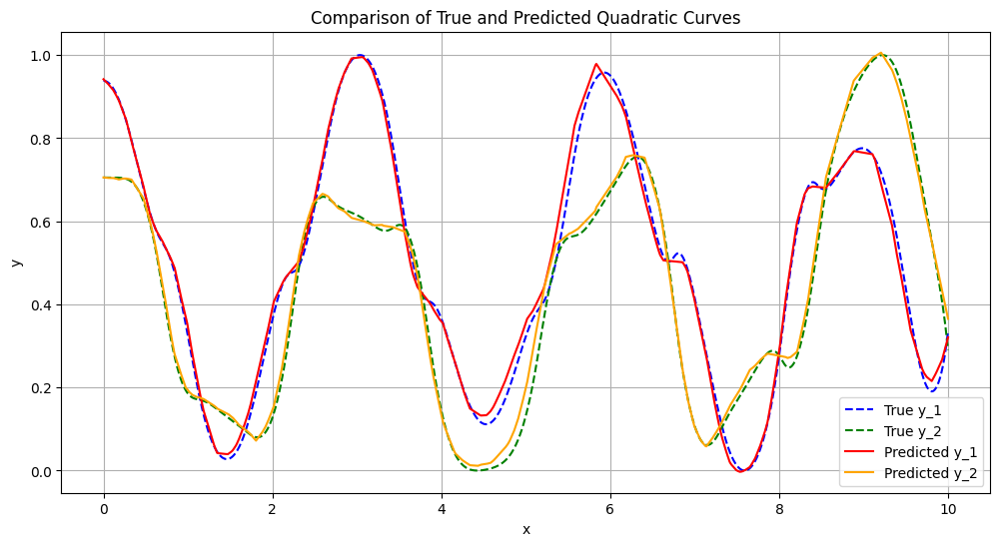

In [7]:
# Generate predictions for 90, 90

angle_to_predict = "90_90"

x_1_any = deeta[angle_to_predict]["x_1"]
x_2_any = deeta[angle_to_predict]["x_2"]
x_any = x[:N]
y_1_any = deeta[angle_to_predict]["y_1"]
y_2_any = deeta[angle_to_predict]["y_2"]

x_dense_combined = np.vstack([x_1_any, x_2_any, x_any]).T
x_dense_scaled = scaler_x.transform(x_dense_combined)
x_dense_tensor = torch.tensor(x_dense_scaled, dtype=torch.float32).unsqueeze(1)  # Shape (500, 1, 2)

srnn.eval()
with torch.no_grad():
    y_pred_scaled = srnn(x_dense_tensor).numpy()

# Inverse transform predictions
y_pred_any = scaler_y.inverse_transform(y_pred_scaled)

# PLOTTING LOOKS A LITTLE OFF BECAUSE IT IS PLOTTING ALL ANGLES, NEEDS TO BE TURNED INTO NUMPY ARRAY AND SET TO NP.WHERE
# x_1 = initial angle 1 and x_2 is initial angle

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(x_any, y_1_any, label='True y_1', color='blue', linestyle='--')
plt.plot(x_any, y_2_any, label='True y_2', color='green', linestyle='--')
plt.plot(x_any, y_pred_any[:, 0], label='Predicted y_1', color='red')
plt.plot(x_any, y_pred_any[:, 1], label='Predicted y_2', color='orange')
plt.xlabel('x')
plt.ylabel('y')
plt.title('Comparison of True and Predicted Quadratic Curves')
plt.legend()
plt.grid(True)
plt.show()

# Animate results

In [14]:
y_pred_any

array([[0.94187313, 0.7054707 ],
       [0.94147074, 0.7054219 ],
       [0.94106835, 0.70537317],
       ...,
       [0.31753892, 0.3691494 ],
       [0.31906396, 0.36720493],
       [0.32058918, 0.36526027]], dtype=float32)

In [26]:
from math import  floor
floor((N/(b-a))/30)

16

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from math import sin, cos, pi, floor

from matplotlib import rc
rc('animation', html='jshtml')

def theta_to_xy(theta1, theta2, theta1Len=1, theta2len=1):
    convert = pi/180
    x1 = sin(theta1*convert) * theta1Len
    y1 = -cos(theta1*convert) * theta1Len
    x2 = x1 + sin(theta2*convert) * theta2len
    y2 = y1 - cos(theta2*convert) * theta2len
    return [x1, y1, x2, y2]

x1_points = []
y1_points = []
x2_points = []
y2_points = []

x1_points_p = []
y1_points_p = []
x2_points_p = []
y2_points_p = []

fps = 30
upframe = floor((N/(b-a))/30)

for z in np.arange(0, N, upframe):
    i = int(z)
    preddy = scaler.inverse_transform(y_pred_any)
    actual = scaler.inverse_transform(data[angle_to_predict])

    x1, y1, x2, y2 = theta_to_xy(actual[i][0], actual[i][1])
    x1_points.append(x1)
    y1_points.append(y1)
    x2_points.append(x2)
    y2_points.append(y2)

    t1 = preddy[i][0]
    t2 = preddy[i][1]

    x1p, y1p, x2p, y2p = theta_to_xy(t1, t2)
    x1_points_p.append(x1p)
    y1_points_p.append(y1p)
    x2_points_p.append(x2p)
    y2_points_p.append(y2p)


fig = plt.figure(figsize=(5, 4))
L = 2
ax = fig.add_subplot(autoscale_on=False, xlim=(-L, L), ylim=(-L, L))
ax.set_aspect('equal')
ax.grid()

line, = ax.plot([], [], 'o-', lw=2)
trace, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
line_p, = ax.plot([], [], 'o-', lw=2)
trace_p, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
time_template = 'time = %.1fs'
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    trace.set_data([], [])
    line_p.set_data([], [])
    trace_p.set_data([], [])
    time_text.set_text('')
    return line, trace, line_p, trace_p, time_text

def update(i):
    thisx = [0, x1_points[i], x2_points[i]]
    thisy = [0, y1_points[i], y2_points[i]]

    history_x = x2_points[:i]
    history_y = y2_points[:i]

    thisx_p = [0, x1_points_p[i], x2_points_p[i]]
    thisy_p = [0, y1_points_p[i], y2_points_p[i]]

    history_x_p = x2_points_p[:i]
    history_y_p = y2_points_p[:i]

    line.set_data(thisx, thisy)
    trace.set_data(history_x, history_y)
    line_p.set_data(thisx_p, thisy_p)
    trace_p.set_data(history_x_p, history_y_p)
    time_text.set_text(time_template % (a+((b-a)*(i / len(np.arange(0, N, upframe))))))
    return line, trace, line_p, trace_p, time_text

ani = FuncAnimation(fig, update, frames=len(np.arange(0, N, upframe)), init_func=init, blit=True, interval=fps)
print(len(tpoints))
print(tpoints)
plt.close()
ani

0
16
32
48
64
80
96
112
128
144
160
176
192
208
224
240
256
272
288
304
320
336
352
368
384
400
416
432
448
464
480
496
512
528
544
560
576
592
608
624
640
656
672
688
704
720
736
752
768
784
800
816
832
848
864
880
896
912
928
944
960
976
992
1008
1024
1040
1056
1072
1088
1104
1120
1136
1152
1168
1184
1200
1216
1232
1248
1264
1280
1296
1312
1328
1344
1360
1376
1392
1408
1424
1440
1456
1472
1488
1504
1520
1536
1552
1568
1584
1600
1616
1632
1648
1664
1680
1696
1712
1728
1744
1760
1776
1792
1808
1824
1840
1856
1872
1888
1904
1920
1936
1952
1968
1984
2000
2016
2032
2048
2064
2080
2096
2112
2128
2144
2160
2176
2192
2208
2224
2240
2256
2272
2288
2304
2320
2336
2352
2368
2384
2400
2416
2432
2448
2464
2480
2496
2512
2528
2544
2560
2576
2592
2608
2624
2640
2656
2672
2688
2704
2720
2736
2752
2768
2784
2800
2816
2832
2848
2864
2880
2896
2912
2928
2944
2960
2976
2992
3008
3024
3040
3056
3072
3088
3104
3120
3136
3152
3168
3184
3200
3216
3232
3248
3264
3280
3296
3312
3328
3344
3360
3376
3392
3408
3

# Plot predictions vs actual for unknown angle

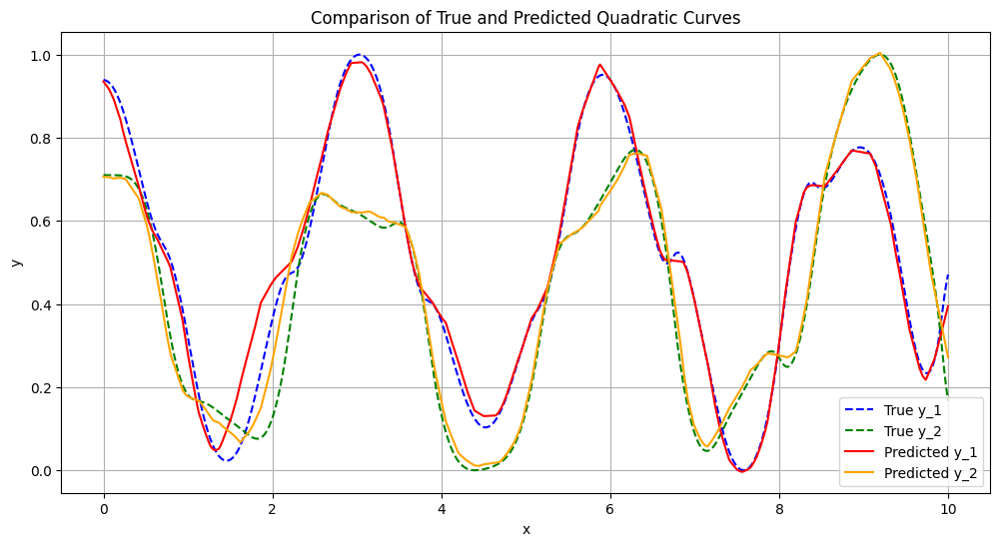

In [51]:
# Generate predictions for 85, 85

angle = [89.5, 89.5]


tpoints = np.arange(a, b, h) # seconds, split into intervals of 100
theta1_points = np.zeros_like(tpoints) # what the first pendulm angle should be (empty)
theta2_points = np.zeros_like(tpoints) # what the second pendulm angle should be (empty)

q = np.array([angle[0]*pi/180, 0, angle[1]*pi/180, 0], float)

for i, t in enumerate(tpoints):
    theta1_points[i] = q[0] * 180 / pi # converted from theta (θ) to degrees (°)
    theta2_points[i] = q[2] * 180 / pi

    k1 = h * f(q, t, L1, L2)
    k2 = h * f(q + 0.5 * k1, t + 0.5 * h, L1, L2)
    k3 = h * f(q + 0.5 * k2, t + 0.5 * h, L1, L2)
    k4 = h * f(q + k3, t + h, L1, L2)
    q += (k1 + 2 * k2 + 2 * k3 + k4) / 6

x_1_unknown = [angle[0]*pi/180]*N
x_2_unknown = [angle[1]*pi/180]*N
x_unknown = tpoints.tolist()
scaler = MinMaxScaler()
y_1_2_unknown = scaler.fit_transform([[a, b] for a, b in zip(theta1_points, theta2_points)])
y_1_unknown, y_2_unknown = map(list, zip(*y_1_2_unknown))

x_dense_combined = np.vstack([x_1_unknown, x_2_unknown, x_unknown]).T
x_dense_scaled = scaler_x.transform(x_dense_combined)
x_dense_tensor = torch.tensor(x_dense_scaled, dtype=torch.float32).unsqueeze(1)  # Shape (500, 1, 2)

srnn.eval()
with torch.no_grad():
    y_pred_scaled = srnn(x_dense_tensor).numpy()

# Inverse transform predictions
y_pred_unknown = scaler_y.inverse_transform(y_pred_scaled)

# PLOTTING LOOKS A LITTLE OFF BECAUSE IT IS PLOTTING ALL ANGLES, NEEDS TO BE TURNED INTO NUMPY ARRAY AND SET TO NP.WHERE
# x_1 = initial angle 1 and x_2 is initial angle

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(x_unknown, y_1_unknown, label='True y_1', color='blue', linestyle='--')
plt.plot(x_unknown, y_2_unknown, label='True y_2', color='green', linestyle='--')
plt.plot(x_unknown, y_pred_unknown[:, 0], label='Predicted y_1', color='red')
plt.plot(x_unknown, y_pred_unknown[:, 1], label='Predicted y_2', color='orange')
plt.xlabel('x')
plt.ylabel('y')
plt.title('Comparison of True and Predicted Quadratic Curves')
plt.legend()
plt.grid(True)
plt.show()

# Animate results for unknown angle

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from math import sin, cos, pi, floor

from matplotlib import rc
rc('animation', html='jshtml')

def theta_to_xy(theta1, theta2, theta1Len=1, theta2len=1):
    convert = pi/180
    x1 = sin(theta1*convert) * theta1Len
    y1 = -cos(theta1*convert) * theta1Len
    x2 = x1 + sin(theta2*convert) * theta2len
    y2 = y1 - cos(theta2*convert) * theta2len
    return [x1, y1, x2, y2]

x1_points = []
y1_points = []
x2_points = []
y2_points = []

x1_points_p = []
y1_points_p = []
x2_points_p = []
y2_points_p = []

fps = 30
upframe = floor((N/(b-a))/30)

for z in np.arange(0, N, upframe):
    i = int(z)
    preddy = scaler.inverse_transform(y_pred_unknown)
    actual = scaler.inverse_transform(y_1_2_unknown)

    x1, y1, x2, y2 = theta_to_xy(actual[i][0], actual[i][1])
    x1_points.append(x1)
    y1_points.append(y1)
    x2_points.append(x2)
    y2_points.append(y2)

    t1 = preddy[i][0]
    t2 = preddy[i][1]

    x1p, y1p, x2p, y2p = theta_to_xy(t1, t2)
    x1_points_p.append(x1p)
    y1_points_p.append(y1p)
    x2_points_p.append(x2p)
    y2_points_p.append(y2p)


fig = plt.figure(figsize=(5, 4))
L = 2
ax = fig.add_subplot(autoscale_on=False, xlim=(-L, L), ylim=(-L, L))
ax.set_aspect('equal')
ax.grid()

line, = ax.plot([], [], 'o-', lw=2)
trace, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
line_p, = ax.plot([], [], 'o-', lw=2)
trace_p, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
time_template = 'time = %.1fs'
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    trace.set_data([], [])
    line_p.set_data([], [])
    trace_p.set_data([], [])
    time_text.set_text('')
    return line, trace, line_p, trace_p, time_text

def update(i):
    thisx = [0, x1_points[i], x2_points[i]]
    thisy = [0, y1_points[i], y2_points[i]]

    history_x = x2_points[:i]
    history_y = y2_points[:i]

    thisx_p = [0, x1_points_p[i], x2_points_p[i]]
    thisy_p = [0, y1_points_p[i], y2_points_p[i]]

    history_x_p = x2_points_p[:i]
    history_y_p = y2_points_p[:i]

    line.set_data(thisx, thisy)
    trace.set_data(history_x, history_y)
    line_p.set_data(thisx_p, thisy_p)
    trace_p.set_data(history_x_p, history_y_p)
    time_text.set_text(time_template % (i * h))
    return line, trace, line_p, trace_p, time_text

ani = FuncAnimation(fig, update, frames=len(np.arange(0, N, upframe)), init_func=init, blit=True, interval=fps)
print(len(tpoints))
print(tpoints)
plt.close()
ani

5000
[0.000e+00 2.000e-03 4.000e-03 ... 9.994e+00 9.996e+00 9.998e+00]


# For testing specific angles (optional)

In [ ]:
# for testing specific angles

srnn.eval()
with torch.no_grad():
    y_pred_scaled = srnn(torch.tensor(scaler_x.transform(np.vstack([pi/2, pi/2, 4]).T), dtype=torch.float32).unsqueeze(1)).numpy()

# Inverse transform predictions
y_prediction_test = scaler_y.inverse_transform(y_pred_scaled)
print(y_prediction_test)

[[0.3064439  0.06659854]]
